# Задача 1
* Постройте график
* Назовите график
* Сделайте именование оси x и оси y
* Сделайте выводы

In [5]:
import pandas as pd
df = pd.read_csv('kc_house_data.csv', sep=',')
df.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.0,3,1.00,1180,5650,1.0,0,0,...,7,1180,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6414100192,20141209T000000,538000.0,3,2.25,2570,7242,2.0,0,0,...,7,2170,400,1951,1991,98125,47.7210,-122.319,1690,7639
2,5631500400,20150225T000000,180000.0,2,1.00,770,10000,1.0,0,0,...,6,770,0,1933,0,98028,47.7379,-122.233,2720,8062
3,2487200875,20141209T000000,604000.0,4,3.00,1960,5000,1.0,0,0,...,7,1050,910,1965,0,98136,47.5208,-122.393,1360,5000
4,1954400510,20150218T000000,510000.0,3,2.00,1680,8080,1.0,0,0,...,8,1680,0,1987,0,98074,47.6168,-122.045,1800,7503


Text(0, 0.5, 'Цена')

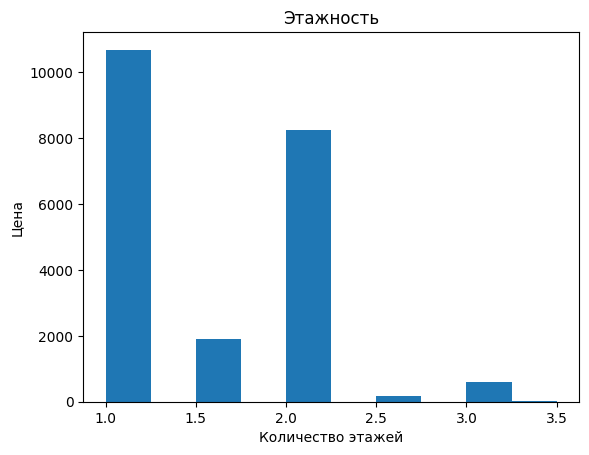

In [7]:
import matplotlib.pyplot as plt

plt.hist(df['floors'])
plt.title('Этажность')
plt.xlabel('Количество этажей')
plt.ylabel('Цена')

## 1.1 Изучите стоимости недвижимости

Text(0, 0.5, 'Количество')

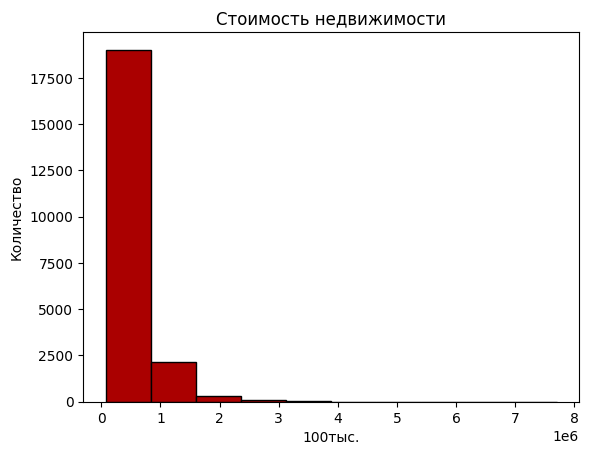

In [27]:
plt.hist(df['price'], edgecolor='black', color='#AA0000')
plt.title('Стоимость недвижимости')
plt.xlabel('100тыс.')
plt.ylabel('Количество')

## 1.3 Изучите распределение квадратуры жилой

Text(0, 0.5, 'Количество домов')

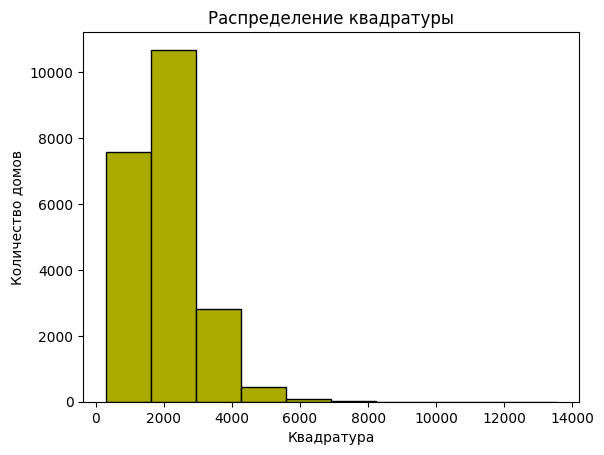

In [28]:
plt.hist(df['sqft_living'], edgecolor='black', color='#AAAA00')
plt.title('Распределение квадратуры')
plt.xlabel('Квадратура')
plt.ylabel('Количество домов')

## 1.4 Изучите распределение года постройки

Text(0, 0.5, 'Количество домов')

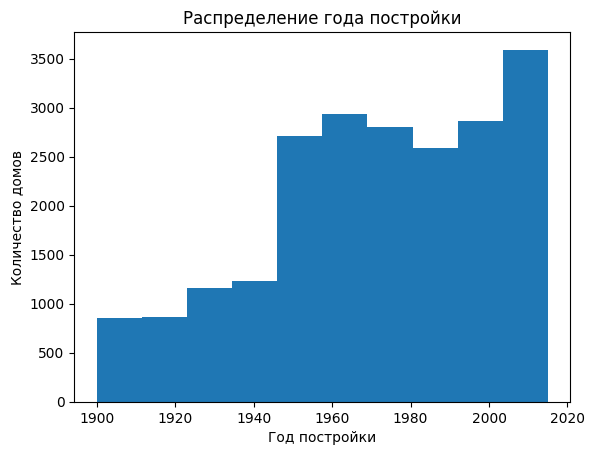

In [19]:
plt.hist(df['yr_built'])
plt.title('Распределение года постройки')
plt.xlabel('Год постройки')
plt.ylabel('Количество домов')

# 2 Задача

## 2.1 Изучите распределение домов от наличия вида на набережную

<BarContainer object of 2 artists>

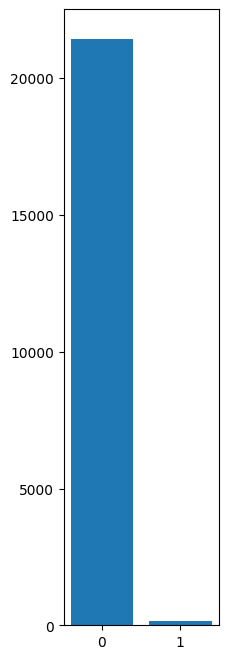

In [13]:
x = df['waterfront'].value_counts()
x
name = x.index
values = x.values
plt.figure(figsize=(2,8))
plt.bar(name, values)

## 2.2 Изучите распределение этажей домов

<BarContainer object of 6 artists>

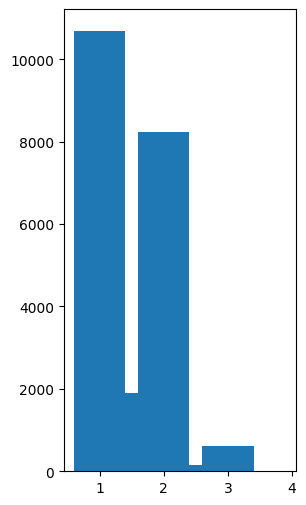

In [15]:
x = df['floors'].value_counts()
x
name = x.index
values = x.values
plt.figure(figsize=(3,6))
plt.bar(name, values)

## 2.3 Изучите распределение состояния домов

<BarContainer object of 5 artists>

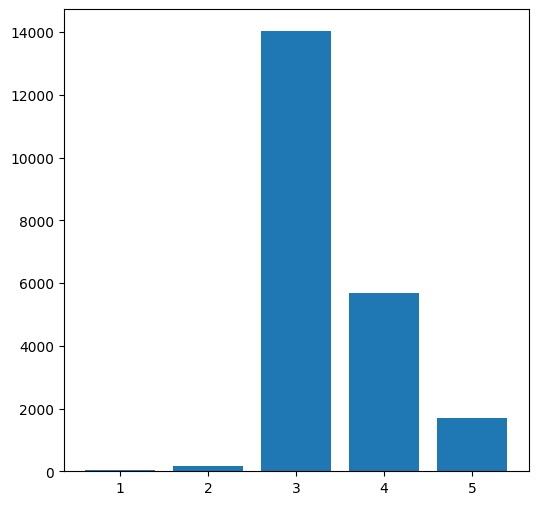

In [17]:
x = df['condition'].value_counts()
x
name = x.index
values = x.values
plt.figure(figsize=(6,6))
plt.bar(name, values)

## 3 Задача

Исследуйте, какие характеристики недвижимости влияют на стоимость недвижимости, с применением не менее 5 диаграмм из урока.
Анализ сделайте в формате storytelling: дополнить каждый график письменными выводами и наблюдениями.

Text(0.5, 1.0, 'Распределение стоимости от количства этажей')

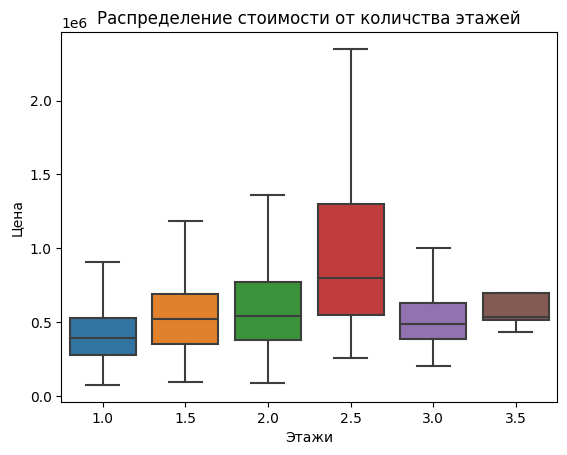

In [49]:
import seaborn as sns
sns.boxplot(x=df['floors'], y=df['price'], showfliers=False)
plt.xlabel('Этажи')
plt.ylabel('Цена')
plt.title('Распределение стоимости от количства этажей')



Видно по графику что при наличии большего количества этажей стоимость дома выше

C:\Users\maxon\AppData\Local\Temp\ipykernel_356\4078257436.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  corr_matrix = df.corr()


<Axes: >

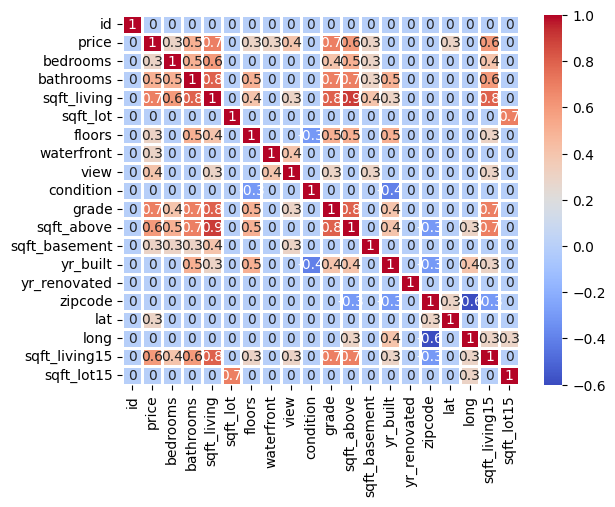

In [40]:
import numpy as np
corr_matrix = df.corr()
corr_matrix = np.round(corr_matrix,1)
corr_matrix[np.abs(corr_matrix) <0.3] = 0
corr_matrix

sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', linewidths=1)


По этому графику трудно сделать какие-то выводы

In [42]:
import folium
this_map = folium.Map(prefer_canvas=True)
def plotDot(point):
    folium.CircleMarker(location=[point.lat,point.long], radius=2,popup=point.price).add_to(this_map)

df.apply(plotDot, axis=1)
this_map.fit_bounds(this_map.get_bounds())
this_map 

Исходя из расположения, те что у моря стоят дороже

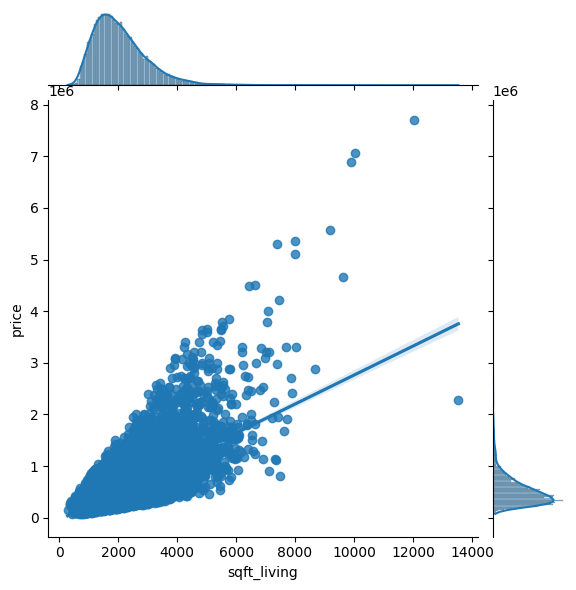

In [54]:
sns.jointplot(x=df['sqft_living'], y=df['price'], kind='reg')

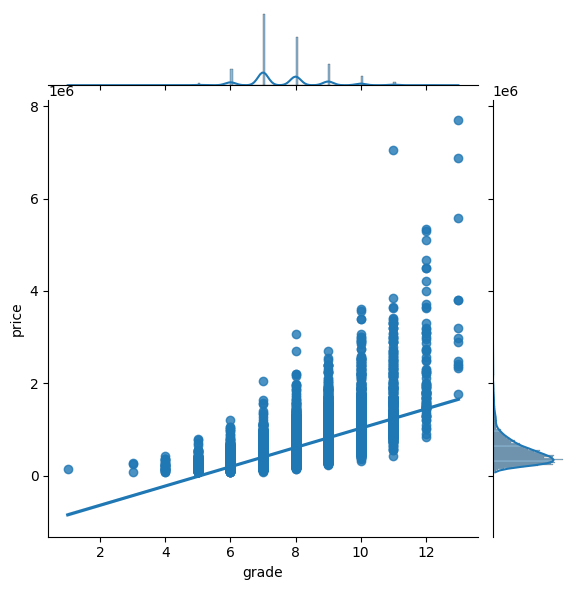

In [55]:
sns.jointplot(x=df['grade'], y=df['price'], kind='reg')

По данному графику видно что чем лучше дизайн, конструкция здания чем цена выше